In [1]:
%pip install numpy
%pip install pandas
%pip install tqdm
%pip install matplotlib
%pip install seaborn
%pip install wordcloud
%pip install folium
%pip install missingno --quiet

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [45]:
from tqdm import tqdm
import pandas as pd
import numpy as np

import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns

from wordcloud import WordCloud

import folium
from folium.plugins import FastMarkerCluster

%matplotlib inline

In [3]:
import warnings

# Ignore warnings
warnings.filterwarnings('ignore')

In [4]:
#Cargar datos desde el archivo CSV
df = pd.read_csv('Dataset/age_dataset.csv')

**Initial EDA (Explolatory Data Analysis)**

In this section, I initiate the Exploratory Data Analysis (EDA) process. I'll start by loading the dataset and gaining a preliminary understanding of its structure.


In [5]:
df.head()

,Id,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy
0,Q23,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,Politician,1732,1799.0,natural causes,67.0,"['United Kingdom', 'United States']","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]"
1,Q42,Douglas Adams,English writer and humorist,Male,United Kingdom,Artist,1952,2001.0,natural causes,49.0,['United Kingdom'],"[(55.378051, -3.435973)]",[81.3]
2,Q91,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,Politician,1809,1865.0,homicide,56.0,['United States'],"[(37.09024, -95.712891)]",[78.5]
3,Q254,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,Artist,1756,1791.0,NaN,35.0,['Austria'],"[(47.516231, 14.550072)]",[81.6]
4,Q255,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,Artist,1770,1827.0,NaN,57.0,"['Austria', 'Italy']","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]"


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1223009 entries, 0 to 1223008
Data columns (total 13 columns):
 #   Column                                    Non-Null Count    Dtype  
---  ------                                    --------------    -----  
 0   Id                                        1223009 non-null  object 
 1   Name                                      1223009 non-null  object 
 2   Short description                         1155109 non-null  object 
 3   Gender                                    1089363 non-null  object 
 4   Country                                   887500 non-null   object 
 5   Occupation                                1016095 non-null  object 
 6   Birth year                                1223009 non-null  int64  
 7   Death year                                1223008 non-null  float64
 8   Manner of death                           53603 non-null    object 
 9   Age of death                              1223008 non-null  float64
 10  Associ

In [7]:
df.describe()

,Birth year,Death year,Age of death
count,1.223009e+06,1.223008e+06,1.223008e+06
mean,1.844972e+03,1.914246e+03,6.927406e+01
std,1.479390e+02,1.516898e+02,1.662938e+01
min,-2.700000e+03,-2.659000e+03,0.000000e+00
25%,1.828000e+03,1.895000e+03,6.000000e+01
50%,1.887000e+03,1.955000e+03,7.200000e+01
75%,1.918000e+03,1.994000e+03,8.100000e+01
max,2.016000e+03,2.021000e+03,1.690000e+02


**Data Cleaning - Drop Unwanted Columns**

In this step, I clean the dataset by removing unnecessary columns that won't contribute to my analysis. This will result in a leaner and more focused DataFrame.

In [8]:
# Drop the "id" column
df = df.drop('Id', axis=1)

In [9]:
df.head()

,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy
0,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,Politician,1732,1799.0,natural causes,67.0,"['United Kingdom', 'United States']","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]"
1,Douglas Adams,English writer and humorist,Male,United Kingdom,Artist,1952,2001.0,natural causes,49.0,['United Kingdom'],"[(55.378051, -3.435973)]",[81.3]
2,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,Politician,1809,1865.0,homicide,56.0,['United States'],"[(37.09024, -95.712891)]",[78.5]
3,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,Artist,1756,1791.0,NaN,35.0,['Austria'],"[(47.516231, 14.550072)]",[81.6]
4,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,Artist,1770,1827.0,NaN,57.0,"['Austria', 'Italy']","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]"


**Data Cleaning - Null Values**

Here, I address missing values in the dataset. Visualizations will help me identify the extent of missing data and guide decisions on how to handle them.


In [10]:
# Quick Glance at Null Values 
df.isnull().sum()

Name                                              0
Short description                             67900
Gender                                       133646
Country                                      335509
Occupation                                   206914
Birth year                                        0
Death year                                        1
Manner of death                             1169406
Age of death                                      1
Associated Countries                         368693
Associated Country Coordinates (Lat/Lon)     368693
Associated Country Life Expectancy           368930
dtype: int64

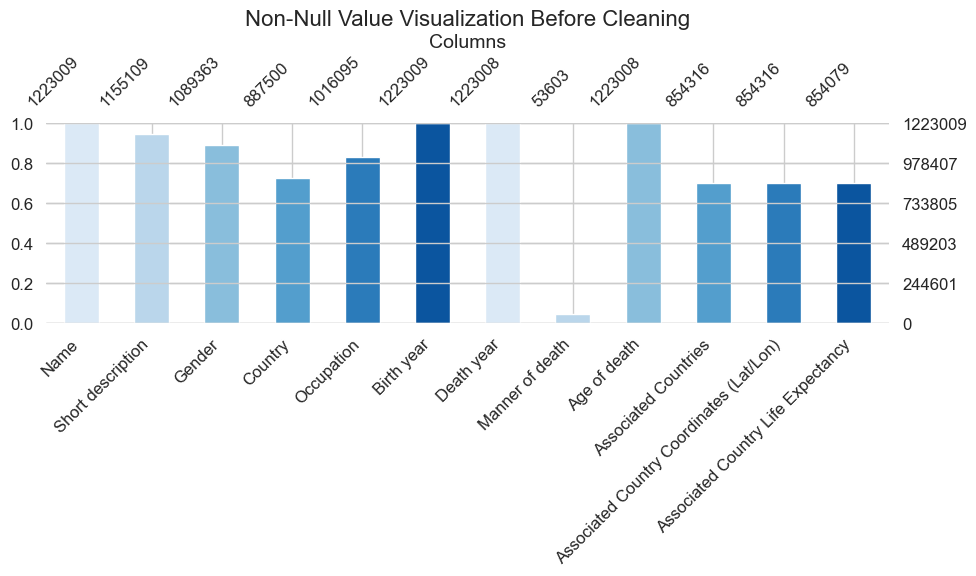

In [11]:
def visualize_missing_values(df):
    sns.set_style('whitegrid')
    sns.set_palette('Blues')
    sns.set_context('notebook', font_scale=1.2)
    
    plt.figure(figsize=(10, 6))
    msno.bar(df, color=sns.color_palette(), figsize=(10, 6), fontsize=12, labels=True)

    plt.title('Non-Null Value Visualization Before Cleaning', fontsize=16)
    plt.xlabel('Columns', fontsize=14)
    plt.ylabel('Percentage of Missing Values', fontsize=14)
    plt.xticks(rotation=45, ha='right')

    plt.tight_layout()
    plt.show()

# Llama a la función pasando tu DataFrame cargado
visualize_missing_values(df)

In [12]:
# Lets Drop rows with null values in 'occupation', 'associated_countries', and 'death_year'
df = df.dropna(subset=['Occupation', 'Associated Countries', 'Death year'], how='any')

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 782779 entries, 0 to 1223008
Data columns (total 12 columns):
 #   Column                                    Non-Null Count   Dtype  
---  ------                                    --------------   -----  
 0   Name                                      782779 non-null  object 
 1   Short description                         778748 non-null  object 
 2   Gender                                    713089 non-null  object 
 3   Country                                   782779 non-null  object 
 4   Occupation                                782779 non-null  object 
 5   Birth year                                782779 non-null  int64  
 6   Death year                                782779 non-null  float64
 7   Manner of death                           44874 non-null   object 
 8   Age of death                              782779 non-null  float64
 9   Associated Countries                      782779 non-null  object 
 10  Associated Country Coord

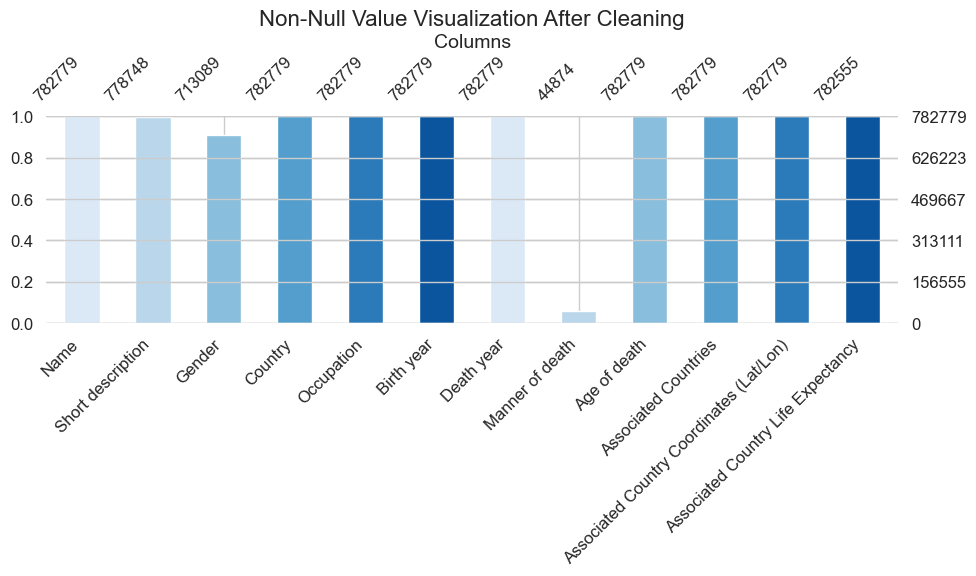

In [14]:
# Visualize Null Values After Cleaning
def visualize_missing_values_after_cleaning(df):
    sns.set_style('whitegrid')
    sns.set_palette('Blues')
    sns.set_context('notebook', font_scale=1.2)
    
    plt.figure(figsize=(10, 6))
    msno.bar(df, color=sns.color_palette(), figsize=(10, 6), fontsize=12, labels=True)

    plt.title('Non-Null Value Visualization After Cleaning', fontsize=16)
    plt.xlabel('Columns', fontsize=14)
    plt.ylabel('Percentage of Missing Values', fontsize=14)
    plt.xticks(rotation=45, ha='right')

    plt.tight_layout()
    plt.show()

# Llama a la función pasando tu DataFrame después de realizar la limpieza
visualize_missing_values_after_cleaning(df)


**Drilling Deeper Into EDA - Correlations**

I explore deeper into the data by investigating correlations between numerical features. A correlation heatmap and dendrogram will provide insights into potential relationships.

In [15]:
# Make a Copy of the Dataframe for EDA Purposes
eda_df = df.copy()

In [16]:
numeric_columns = eda_df.select_dtypes(include=['float64', 'int64'])

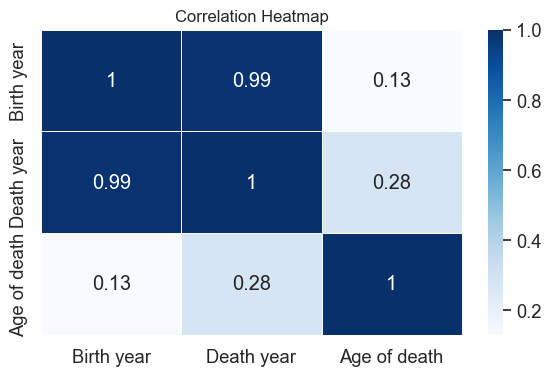

In [17]:
# Create a correlation heatmap for numerical Features
correlation_matrix = numeric_columns.corr()
plt.figure(figsize=(6, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='Blues', linewidths=0.5)
plt.title('Correlation Heatmap', fontsize=12)


plt.tight_layout()
plt.show()

<Figure size 1200x800 with 0 Axes>

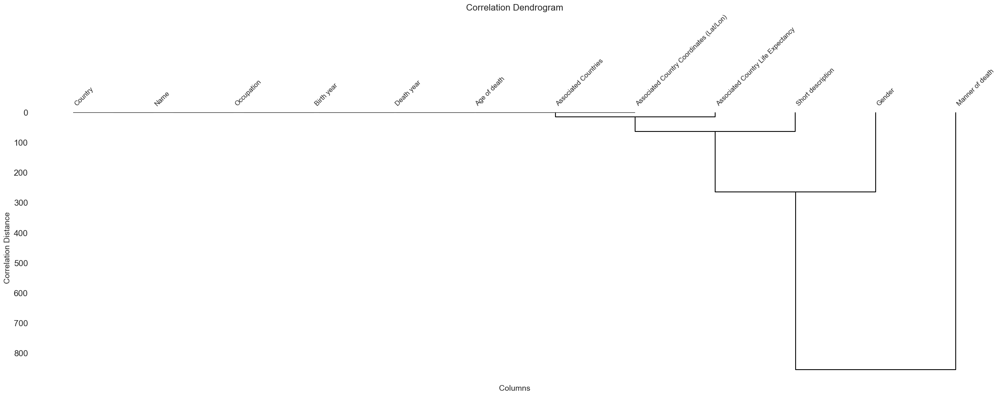

In [18]:
# Create a Dendrogram To Visualize the Correlation
def create_correlation_dendrogram(df):
    sns.set_context('notebook', font_scale=1.2)
    
    plt.figure(figsize=(12, 8))
    msno.dendrogram(df, fontsize=12)
    
    plt.title('Correlation Dendrogram', fontsize=16)
    plt.xlabel('Columns', fontsize=14)
    plt.ylabel('Correlation Distance', fontsize=14)
    
    plt.tight_layout()
    plt.show()

# Llama a la función pasando tu DataFrame
create_correlation_dendrogram(df)


**Data Preprocesing**

In this section, I preprocess the data to enhance its suitability for analysis. I'll add informative columns and transform existing ones to improve the quality of my insights.

In [19]:
processed_df = df.copy()

In [20]:
# Adding a New Column Called Number of Citizenships depending on number of countries the person was associated with
processed_df['Number of Citizenships'] = processed_df['Country'].apply(lambda x: len(x.split(';')))

In [21]:
def calculate_average(value):
    try:
        val = eval(value)
    except:
        return np.nan
    
    return np.mean(val)

In [22]:
processed_df['Expected Life Expectancy'] = df['Associated Country Life Expectancy'].apply(calculate_average)

In [23]:
processed_df.head()

,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy,Number of Citizenships,Expected Life Expectancy
0,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,Politician,1732,1799.0,natural causes,67.0,"['United Kingdom', 'United States']","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]",2,79.90
1,Douglas Adams,English writer and humorist,Male,United Kingdom,Artist,1952,2001.0,natural causes,49.0,['United Kingdom'],"[(55.378051, -3.435973)]",[81.3],1,81.30
2,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,Politician,1809,1865.0,homicide,56.0,['United States'],"[(37.09024, -95.712891)]",[78.5],1,78.50
3,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,Artist,1756,1791.0,NaN,35.0,['Austria'],"[(47.516231, 14.550072)]",[81.6],2,81.60
4,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,Artist,1770,1827.0,NaN,57.0,"['Austria', 'Italy']","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]",2,82.25


In [24]:
def convert_string_to_array(value):
    try:
        val = eval(value)
        return val
    except:
        return np.nan

In [25]:
processed_df["Associated Countries"] = processed_df["Associated Countries"].apply(convert_string_to_array)
processed_df["Associated Country Life Expectancy"] = processed_df["Associated Country Life Expectancy"].apply(convert_string_to_array)
processed_df["Associated Country Coordinates (Lat/Lon)"] = processed_df["Associated Country Coordinates (Lat/Lon)"].apply(convert_string_to_array)
processed_df.head()

,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy,Number of Citizenships,Expected Life Expectancy
0,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,Politician,1732,1799.0,natural causes,67.0,"[United Kingdom, United States]","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]",2,79.90
1,Douglas Adams,English writer and humorist,Male,United Kingdom,Artist,1952,2001.0,natural causes,49.0,[United Kingdom],"[(55.378051, -3.435973)]",[81.3],1,81.30
2,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,Politician,1809,1865.0,homicide,56.0,[United States],"[(37.09024, -95.712891)]",[78.5],1,78.50
3,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,Artist,1756,1791.0,NaN,35.0,[Austria],"[(47.516231, 14.550072)]",[81.6],2,81.60
4,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,Artist,1770,1827.0,NaN,57.0,"[Austria, Italy]","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]",2,82.25


In [26]:
def break_string_to_array(value):
    if type(value) == float:
        return np.nan
    
    if ";" in value:
        arr =value.split(";")
    else:
        arr = [value]
    
    arr = [x.strip() for x in arr]
    return arr

In [27]:
processed_df['Occupation'] = processed_df['Occupation'].apply(break_string_to_array)

In [28]:
processed_df['Manner of death'] = processed_df['Manner of death'].apply(break_string_to_array)

In [29]:
def get_first_value_only(value):
    if type(value) == float:
        return np.nan
    
    if ";" in value:
        arr =value.split(";")
    else:
        arr = [value]
    
    arr = [x.strip() for x in arr]
    return arr[0]

In [30]:
processed_df["Gender"] = processed_df["Gender"].apply(get_first_value_only)

In [31]:
processed_df.head()

,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy,Number of Citizenships,Expected Life Expectancy
0,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,[Politician],1732,1799.0,[natural causes],67.0,"[United Kingdom, United States]","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]",2,79.90
1,Douglas Adams,English writer and humorist,Male,United Kingdom,[Artist],1952,2001.0,[natural causes],49.0,[United Kingdom],"[(55.378051, -3.435973)]",[81.3],1,81.30
2,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,[Politician],1809,1865.0,[homicide],56.0,[United States],"[(37.09024, -95.712891)]",[78.5],1,78.50
3,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,[Artist],1756,1791.0,NaN,35.0,[Austria],"[(47.516231, 14.550072)]",[81.6],2,81.60
4,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,[Artist],1770,1827.0,NaN,57.0,"[Austria, Italy]","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]",2,82.25


**Data Visualization - Visualizing the Gender Distribution**

Visualizing the gender distribution helps me understand the diversity within my dataset. A pie chart will succinctly showcase the proportion of different genders.

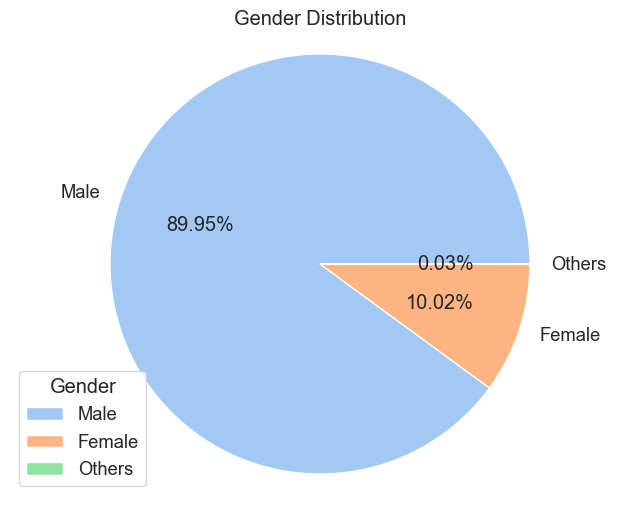

In [32]:
# Count the occurrences of each gender
gender_counts = processed_df['Gender'].value_counts()

# Combine other genders into "Others"
min_percentage = 2  # Minimum percentage for individual category display
others_count = gender_counts[~gender_counts.index.isin(['Male', 'Female'])].sum()
small_categories = gender_counts[gender_counts < (min_percentage / 100 * processed_df.shape[0])]
small_categories_count = small_categories.sum()
gender_counts = gender_counts[gender_counts.index.isin(['Male', 'Female'])]
gender_counts['Others'] = others_count + small_categories_count

# Create a pie chart using Seaborn colors
plt.figure(figsize=(8, 6))
plt.pie(gender_counts, labels=gender_counts.index, autopct='%1.2f%%', colors=sns.color_palette('pastel'))
plt.title('Gender Distribution')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Add legend
plt.legend(title='Gender', labels=gender_counts.index, loc='best')

# Display the pie chart
plt.show()


**Data Visualization - Ages at which People Died**

This visualization highlights the age distribution at which individuals in my dataset passed away. A pie chart with age ranges will provide an informative visual summary.

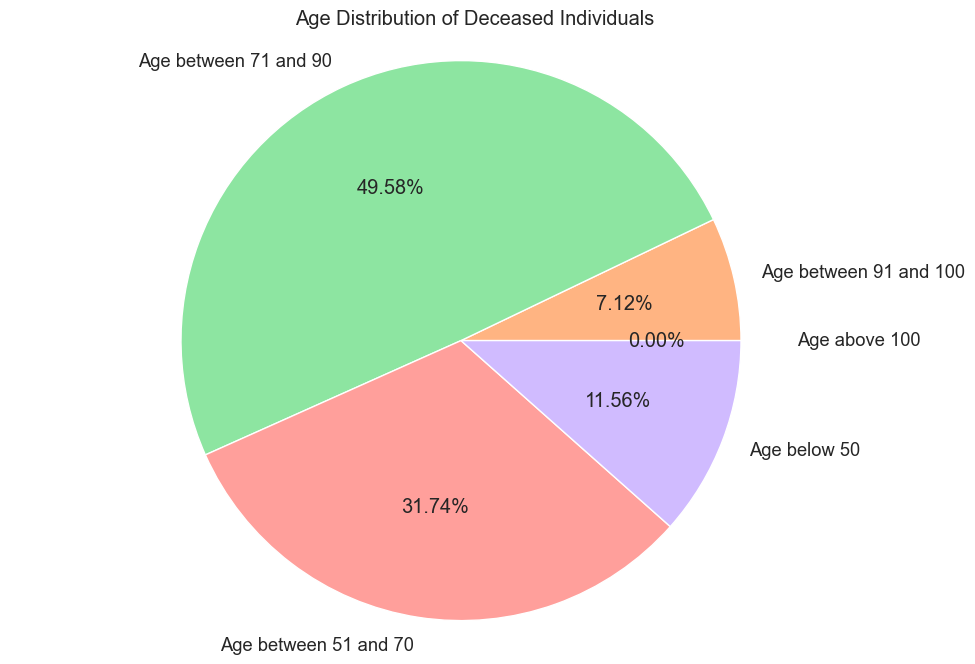

In [33]:
# Calculate the number of people in each age range
age_ranges = [(100, float('inf')), (90, 100), (70, 90), (50, 70), (0, 50)]
count = []

for age_range in age_ranges:
    lower_bound, upper_bound = age_range
    range_count = processed_df[(processed_df['Age of death'] > lower_bound) & (processed_df['Age of death'] <= upper_bound)].shape[0]
    count.append(range_count)

# Define labels and explode
age_labels = ['Age above 100', 'Age between 91 and 100', 'Age between 71 and 90', 'Age between 51 and 70', 'Age below 50']
explode = [0.1, 0, 0, 0, 0]

# Create a pie chart using Seaborn colors
plt.figure(figsize=(12, 8))
plt.pie(count, labels=age_labels, colors=sns.color_palette('pastel'), explode=explode, autopct='%.2f%%')
plt.title("Age Distribution of Deceased Individuals")
plt.axis('equal')

# Display the pie chart
plt.show()

**Data Visualization - Top 10 Most Represented Countries**

Visualizing the top 10 most represented countries will showcase the geographical diversity of my data. A bar chart will help compare their occurrences.

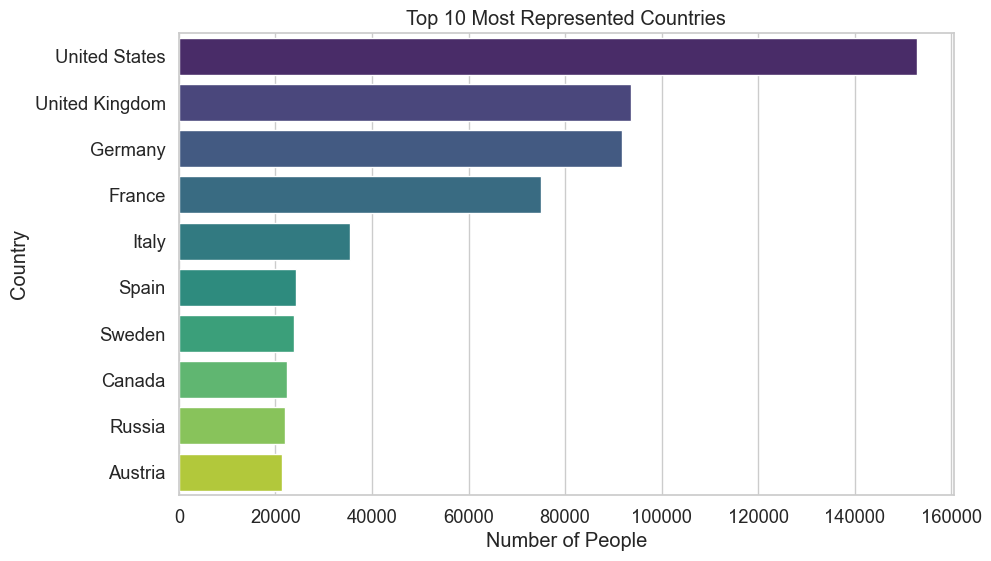

In [34]:
# Convert the arrays in the 'Associated Countries' column to individual rows using explode()
df_exploded =  processed_df.explode('Associated Countries')

# Count the occurrences of each country
top_countries = df_exploded['Associated Countries'].value_counts().reset_index()
top_countries.columns = ['Country', 'Count']

# Filter the top 10 most represented countries
top_countries = top_countries.head(10)

# Create a bar chart using Seaborn
plt.figure(figsize=(10, 6))
sns.barplot(data=top_countries, x='Count', y='Country', palette='viridis')
plt.title('Top 10 Most Represented Countries')
plt.xlabel('Number of People')
plt.ylabel('Country')
plt.show()

**Data Visualization - Birth Year Distibution**

Analyzing the distribution of birth years enriches my understanding of temporal patterns. A line plot will reveal trends and focal points.

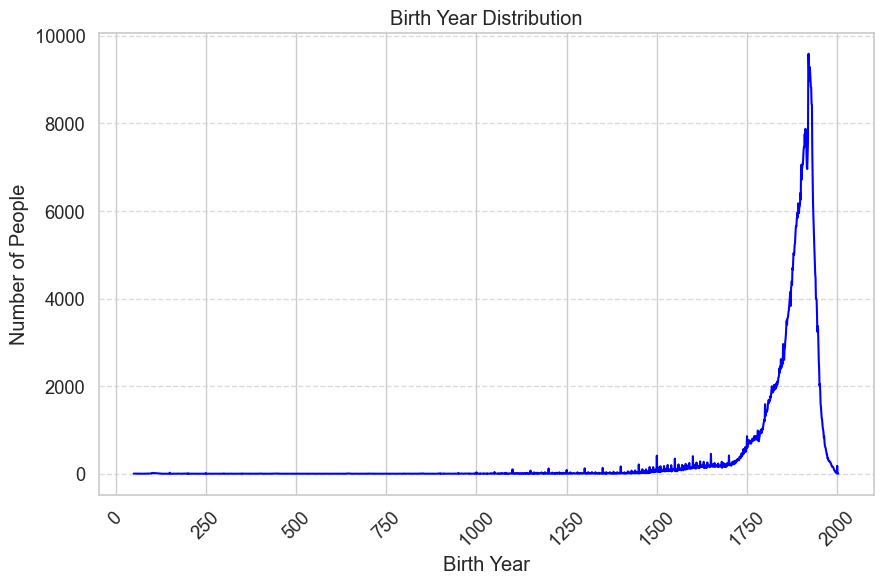

In [35]:
# Filter out birth years that are above 0
filtered_df = processed_df[processed_df['Birth year'] > 0]

# Group the data by birth year and count the occurrences
birth_year_counts = filtered_df['Birth year'].value_counts().reset_index()
birth_year_counts.columns = ['Birth year', 'Count']
birth_year_counts = birth_year_counts.sort_values('Birth year')

# Create a line plot using Seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=birth_year_counts, x='Birth year', y='Count', color='b')
plt.title('Birth Year Distribution')
plt.xlabel('Birth Year')
plt.ylabel('Number of People')
plt.xticks(rotation=45)
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()

**Data Visualization - Common Ways People Have Died**

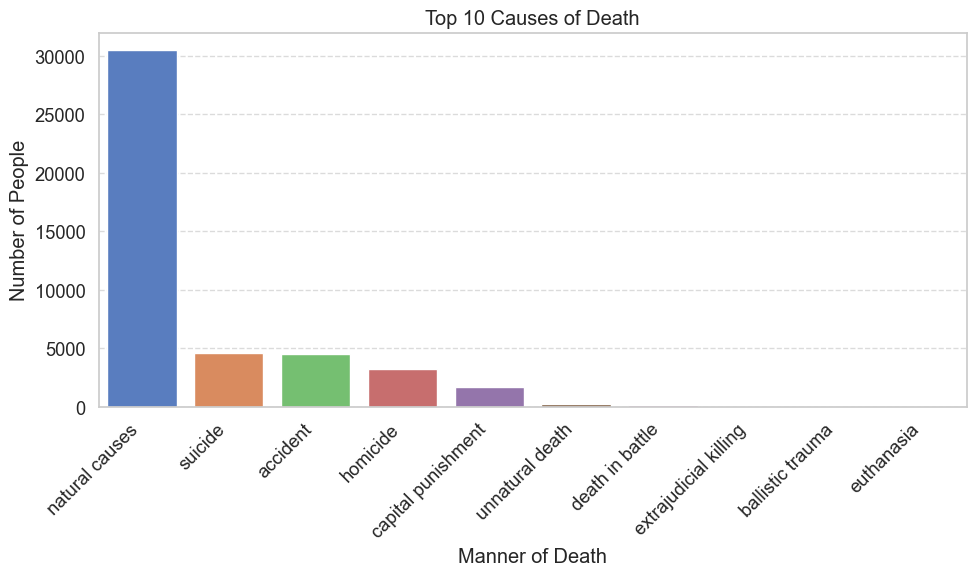

In [36]:
# Explode the 'Manner of death' column to create a new row for each element in the list
exploded_df = processed_df.explode('Manner of death')

# Get the top 10 ways of death
top_10_ways_of_death = exploded_df['Manner of death'].value_counts().nlargest(10)

# Create a bar plot using Seaborn
plt.figure(figsize=(10, 6))
sns.countplot(data=exploded_df, x='Manner of death', order=top_10_ways_of_death.index, palette='muted')
plt.title('Top 10 Causes of Death')
plt.xlabel('Manner of Death')
plt.ylabel('Number of People')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

**Data Visualization - Occupation by individuals roles**

Exploring the most common occupations in the dataset provides insight into individuals' roles. A horizontal bar plot will offer a clear comparison.

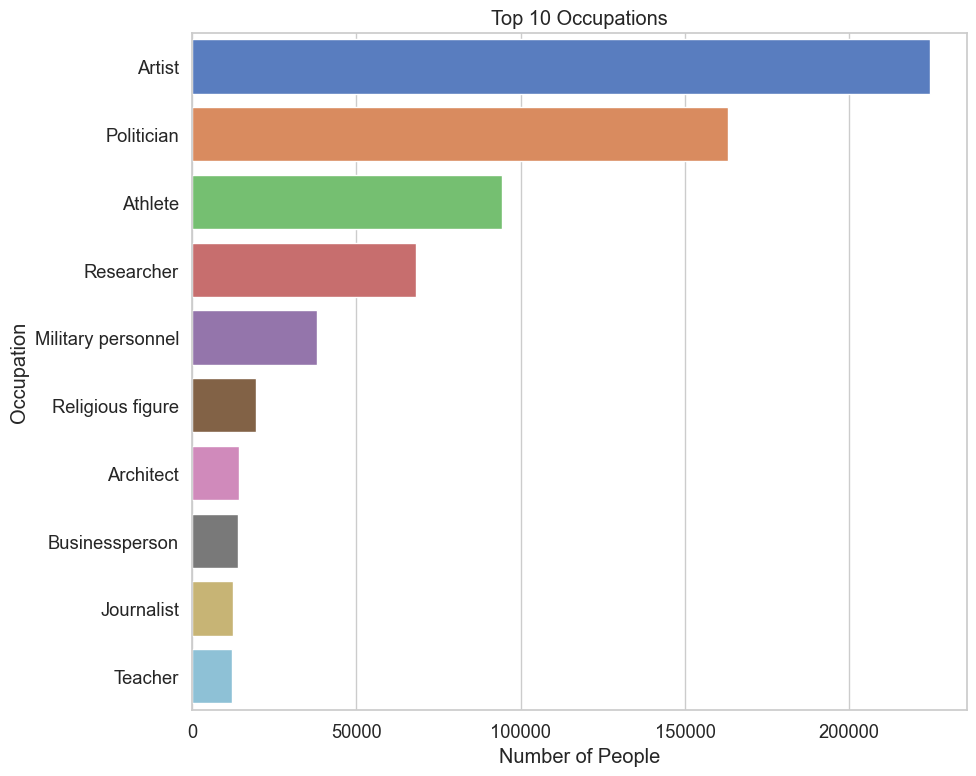

In [37]:
# Explode the 'Occupation' column to create a new row for each occupation in the list
exploded_df = processed_df.explode('Occupation')

# Get the counts of each occupation
occupation_counts = exploded_df['Occupation'].value_counts()

# Select only the top 10 occupations
top_10_occupations = occupation_counts.head(10)

# Create a horizontal bar plot using Seaborn
plt.figure(figsize=(10, 8))
sns.barplot(y=top_10_occupations.index, x=top_10_occupations.values, palette='muted')
plt.title('Top 10 Occupations')
plt.xlabel('Number of People')
plt.ylabel('Occupation')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

**Data Visualization - Life Expectancy vs Gender**

Comparing life expectancy based on gender reveals potential gender-based patterns. A violin plot will showcase distributions and medians.

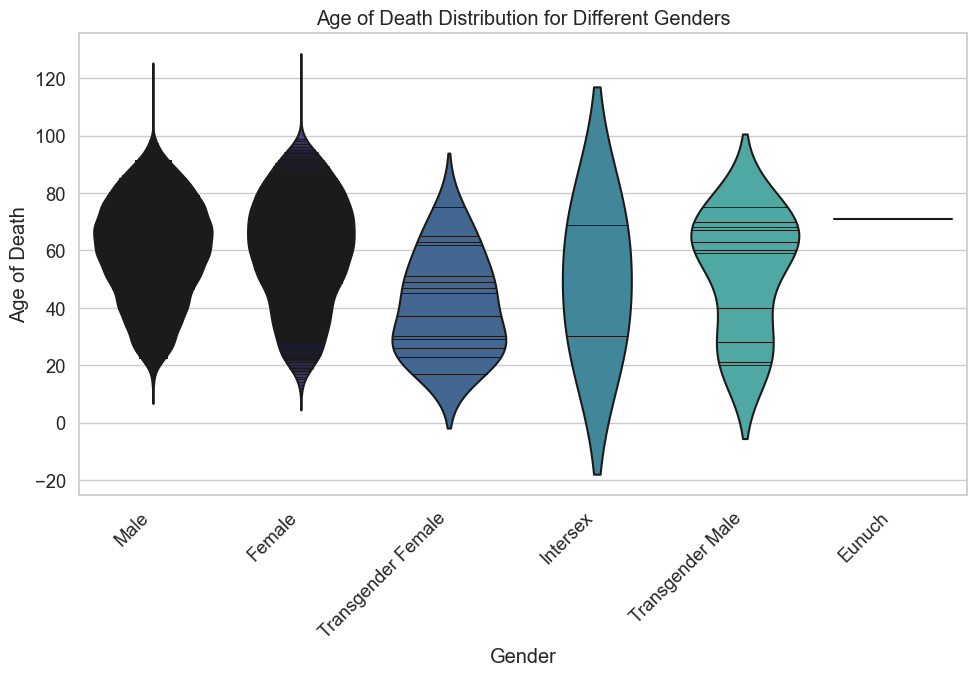

In [38]:
plt.figure(figsize=(10, 7))

# Create a violin plot using Seaborn
sns.violinplot(data=processed_df.dropna(), x='Gender', y='Age of death', palette='mako', inner='stick')

plt.title('Age of Death Distribution for Different Genders')
plt.xlabel('Gender')
plt.ylabel('Age of Death')

# Adjust x-tick labels placement and rotation
plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()


**Data Visualization - Life Expectancy vs Birth Year**

This visualization dives deeper into the relationship between life expectancy and birth year. Scatter and KDE plots will highlight patterns.

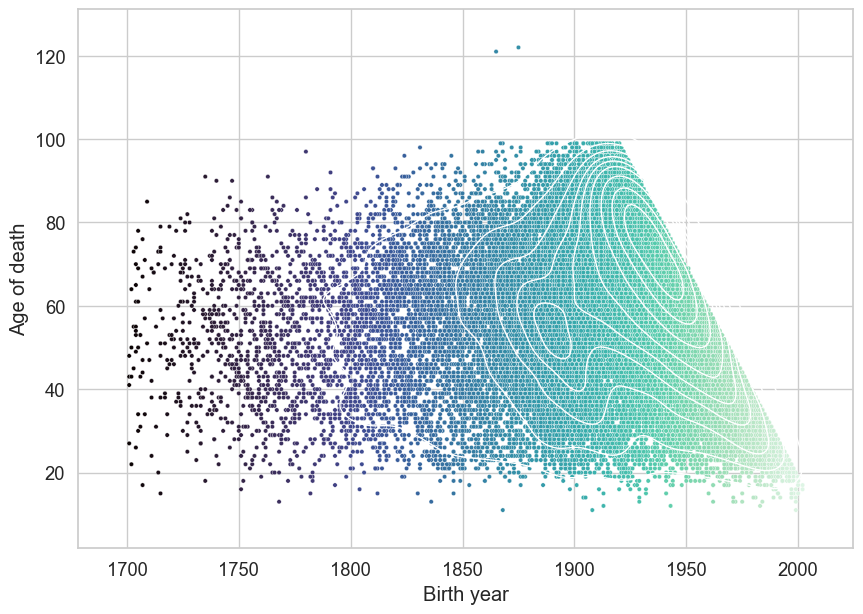

In [39]:
# Filter the DataFrame for birth year above 1700 and age of death above 1500
filtered_df = processed_df[(processed_df['Birth year'] > 1700)].dropna()


f, ax = plt.subplots(figsize=(10, 7))
sns.scatterplot(data=filtered_df, x='Birth year', y='Age of death', s=10, hue='Birth year', palette='mako', legend=False)
sns.kdeplot(data=filtered_df, x='Birth year', y='Age of death', levels=10, color="w", linewidths=1)

plt.show()

**Data Visualization - Link Between Country and Manner of Death**

An advanced visualization explores whether a connection exists between country of origin and cause of death. Stacked bar charts depict these relationships.

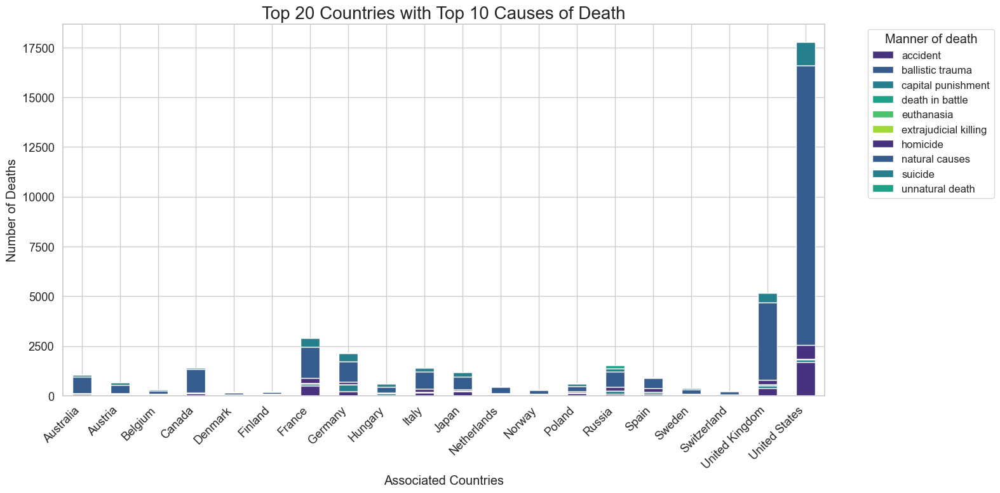

In [40]:
# Explode both 'Associated Countries' and 'Manner of death' columns
exploded_df = processed_df.explode('Associated Countries').explode('Manner of death').reset_index(drop=True)

# Get the top 20 countries
top_20_countries = exploded_df['Associated Countries'].value_counts().nlargest(20)

# Get the top 10 overall causes of death
top_10_manner_of_death = exploded_df['Manner of death'].value_counts().nlargest(10)

# Filter the exploded DataFrame to include only the top 20 countries and top 10 manner of death
filtered_df = exploded_df[exploded_df['Associated Countries'].isin(top_20_countries.index) &
                          exploded_df['Manner of death'].isin(top_10_manner_of_death.index)]

# Create a cross-tabulation to count occurrences of 'Manner of death' for each 'Associated Countries'
ct = pd.crosstab(filtered_df['Associated Countries'], filtered_df['Manner of death'])

# Create a stacked bar chart with counts using Seaborn
plt.figure(figsize=(16, 8))
sns.set_palette('viridis')
ax = ct.plot(kind='bar', stacked=True, ax=plt.gca())

plt.title('Top 20 Countries with Top 10 Causes of Death', fontdict={'fontsize': 20})
plt.xlabel('Associated Countries')
plt.ylabel('Number of Deaths')
plt.xticks(rotation=45, ha='right')

# Move the legend outside the plot
plt.legend(title='Manner of death', bbox_to_anchor=(1.05, 1), loc='upper left', prop={'size': 12})

plt.tight_layout()
plt.show()


**Geo Visualization with Associated Countries**

Using geographical visualization, I'll map countries associated with individuals in the dataset. A marker cluster map will illustrate their distribution.

In [41]:
import folium
from folium.plugins import FastMarkerCluster

def create_associated_countries_map(df):
    # Create a copy of the DataFrame for plotting the map
    map_df = df.copy()

    # Explode the coordinates column
    map_df = map_df.explode('Associated Countries')
    map_df = map_df.explode('Associated Country Coordinates (Lat/Lon)')
    map_df = map_df.dropna(subset=["Associated Country Coordinates (Lat/Lon)"])

    # Extract 'Lat' and 'Lon' values using lambda function
    map_df['Lat'] = map_df['Associated Country Coordinates (Lat/Lon)'].apply(lambda x: pd.Series(x[0]))
    map_df['Lon'] = map_df['Associated Country Coordinates (Lat/Lon)'].apply(lambda x: pd.Series(x[1]))

    # Drop rows with missing coordinates
    map_df = map_df.dropna(subset=['Lat', 'Lon'], how="any")

    # Create a Folium map
    folium_map = folium.Map(location=[20, 0], zoom_start=2, tiles='CartoDB dark_matter')

    # Add the FastMarkerCluster to the map
    FastMarkerCluster(data=list(zip(map_df['Lat'].values, map_df['Lon'].values))).add_to(folium_map)

    # Add layer control to the map
    folium.LayerControl().add_to(folium_map)

    return folium_map

# Call the function with your DataFrame to create the map
map = create_associated_countries_map(processed_df)
map


**First Name World Cloud**

Creating a word cloud based on first names provides a visual representation of name popularity.

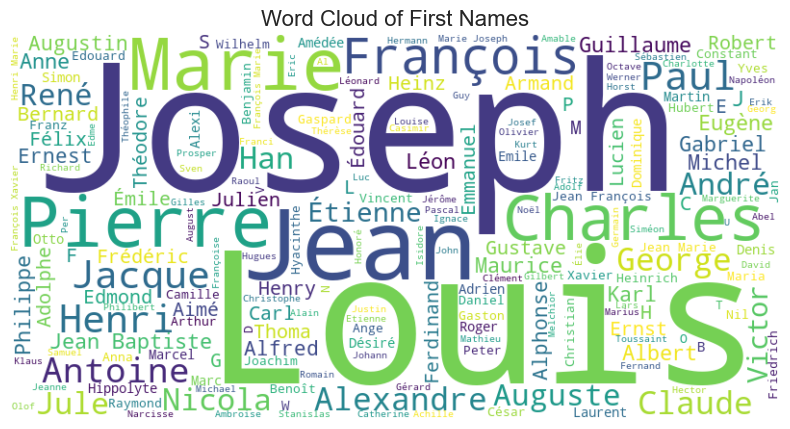

In [42]:
from wordcloud import WordCloud

def create_word_cloud_from_names(df):
    # Extract first names from the 'Name' column without modifying the original DataFrame
    first_names_df = df['Name'].str.split(expand=True)[0].str.strip().str.title()

    # Create a set of unique first names
    unique_first_names = set(first_names_df)

    # Combine all unique first names into a single string
    all_first_names = ' '.join(unique_first_names)

    # Create a Word Cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_first_names)

    # Visualize the Word Cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('Word Cloud of First Names', fontsize=16)
    plt.show()

# Call the function with your DataFrame to create the word cloud
create_word_cloud_from_names(processed_df)


**Last Name World Cloud**

Similar to the first name cloud, a last name word cloud captures the diversity of last names.

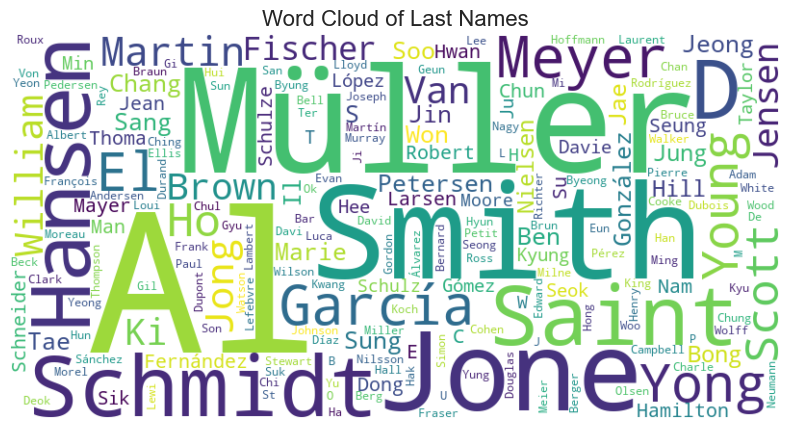

In [43]:
from wordcloud import WordCloud

def create_word_cloud_from_last_names(df):
    # Extract last names from the 'Name' column without modifying the original DataFrame
    last_names_df = df['Name'].str.split(expand=True)[1].str.strip().str.title()

    # Create a set of unique last names and remove None values
    unique_last_names = set(last_names_df.dropna())

    # Combine all unique last names into a single string
    all_last_names = ' '.join(unique_last_names)

    # Create a Word Cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_last_names)

    # Visualize the Word Cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('Word Cloud of Last Names', fontsize=16)
    plt.show()

# Call the function with your DataFrame to create the word cloud
create_word_cloud_from_last_names(processed_df)


**Top 10 Causes of Death Analysis**

Analyzing the top causes of death, with a gender breakdown, offers valuable insights into mortality patterns.


<Figure size 1000x800 with 0 Axes>

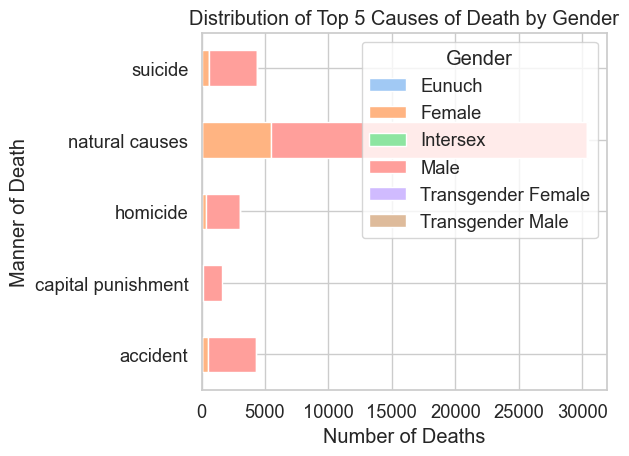

In [44]:
# Assuming 'Manner of death' is a list column, let's flatten it first
processed_df['Manner of death'] = processed_df['Manner of death'].apply(lambda x: x[0] if isinstance(x, list) else x)

# Get the top 10 causes of death
top_5_manner_of_death = processed_df['Manner of death'].value_counts().nlargest(5).index

# Filter the DataFrame to include only the top 10 causes of death
filtered_df = processed_df[processed_df['Manner of death'].isin(top_5_manner_of_death)]

# Count the occurrences of each manner of death by gender
cross_tab = pd.crosstab(filtered_df['Manner of death'], filtered_df['Gender'])

# Plot a horizontal bar chart
plt.figure(figsize=(10, 8))
sns.set_palette('pastel')
cross_tab.plot(kind='barh', stacked=True)
plt.title('Distribution of Top 5 Causes of Death by Gender')
plt.xlabel('Number of Deaths')
plt.ylabel('Manner of Death')
plt.legend(title='Gender', loc='upper right')
plt.tight_layout()
plt.show()